In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, train_test_split, StratifiedKFold
from sklearn.ensemble import StackingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from imblearn.pipeline import Pipeline
from imblearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import plot_precision_recall_curve
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import f1_score
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)

In [2]:
data1 = pd.read_csv('churn-bigml-80.csv')
data1.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,No,Yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,No,Yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,No,No,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,Yes,No,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,Yes,No,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [3]:
data2 = pd.read_csv('churn-bigml-20.csv')
data2.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,LA,117,408,No,No,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
1,IN,65,415,No,No,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True
2,NY,161,415,No,No,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True
3,SC,111,415,No,No,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,False
4,HI,49,510,No,No,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,False


In [4]:
df = pd.concat([data1, data2])
df.head()

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,KS,128,415,No,Yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,No,Yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,No,No,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,Yes,No,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,Yes,No,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [5]:
df.shape

(3333, 20)

In [6]:
df.isnull().sum()

State                     0
Account length            0
Area code                 0
International plan        0
Voice mail plan           0
Number vmail messages     0
Total day minutes         0
Total day calls           0
Total day charge          0
Total eve minutes         0
Total eve calls           0
Total eve charge          0
Total night minutes       0
Total night calls         0
Total night charge        0
Total intl minutes        0
Total intl calls          0
Total intl charge         0
Customer service calls    0
Churn                     0
dtype: int64

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3333 entries, 0 to 666
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State                   3333 non-null   object 
 1   Account length          3333 non-null   int64  
 2   Area code               3333 non-null   int64  
 3   International plan      3333 non-null   object 
 4   Voice mail plan         3333 non-null   object 
 5   Number vmail messages   3333 non-null   int64  
 6   Total day minutes       3333 non-null   float64
 7   Total day calls         3333 non-null   int64  
 8   Total day charge        3333 non-null   float64
 9   Total eve minutes       3333 non-null   float64
 10  Total eve calls         3333 non-null   int64  
 11  Total eve charge        3333 non-null   float64
 12  Total night minutes     3333 non-null   float64
 13  Total night calls       3333 non-null   int64  
 14  Total night charge      3333 non-null   f

In [8]:
df["Churn"] = df["Churn"].replace("False", 0).replace("True", 1).astype("int")

In [9]:
dfC = pd.get_dummies(df.drop("Churn",axis=1),drop_first=True)
dfC["Churn"] = df["Churn"]
dfC

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,...,State_UT,State_VA,State_VT,State_WA,State_WI,State_WV,State_WY,International plan_Yes,Voice mail plan_Yes,Churn
0,128,415,25,265.1,110,45.07,197.4,99,16.78,244.7,...,0,0,0,0,0,0,0,0,1,0
1,107,415,26,161.6,123,27.47,195.5,103,16.62,254.4,...,0,0,0,0,0,0,0,0,1,0
2,137,415,0,243.4,114,41.38,121.2,110,10.30,162.6,...,0,0,0,0,0,0,0,0,0,0
3,84,408,0,299.4,71,50.90,61.9,88,5.26,196.9,...,0,0,0,0,0,0,0,1,0,0
4,75,415,0,166.7,113,28.34,148.3,122,12.61,186.9,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,114,415,26,137.1,88,23.31,155.7,125,13.23,247.6,...,0,0,0,0,1,0,0,0,1,0
663,106,408,29,83.6,131,14.21,203.9,131,17.33,229.5,...,0,0,0,0,0,0,0,0,1,0
664,60,415,0,193.9,118,32.96,85.0,110,7.23,210.1,...,0,0,1,0,0,0,0,0,0,0
665,159,415,0,169.8,114,28.87,197.7,105,16.80,193.7,...,0,0,0,0,0,1,0,0,0,0


In [12]:
df = pd.get_dummies(df,drop_first=True)

In [13]:
df.columns

Index(['Account length', 'Area code', 'Number vmail messages',
       'Total day minutes', 'Total day calls', 'Total day charge',
       'Total eve minutes', 'Total eve calls', 'Total eve charge',
       'Total night minutes', 'Total night calls', 'Total night charge',
       'Total intl minutes', 'Total intl calls', 'Total intl charge',
       'Customer service calls', 'Churn', 'State_AL', 'State_AR', 'State_AZ',
       'State_CA', 'State_CO', 'State_CT', 'State_DC', 'State_DE', 'State_FL',
       'State_GA', 'State_HI', 'State_IA', 'State_ID', 'State_IL', 'State_IN',
       'State_KS', 'State_KY', 'State_LA', 'State_MA', 'State_MD', 'State_ME',
       'State_MI', 'State_MN', 'State_MO', 'State_MS', 'State_MT', 'State_NC',
       'State_ND', 'State_NE', 'State_NH', 'State_NJ', 'State_NM', 'State_NV',
       'State_NY', 'State_OH', 'State_OK', 'State_OR', 'State_PA', 'State_RI',
       'State_SC', 'State_SD', 'State_TN', 'State_TX', 'State_UT', 'State_VA',
       'State_VT', 'State_WA'

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\relational.py:950: UserWarning: You passed a edgecolor/edgecolors ('w') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  points = ax.scatter(*args, **kws)


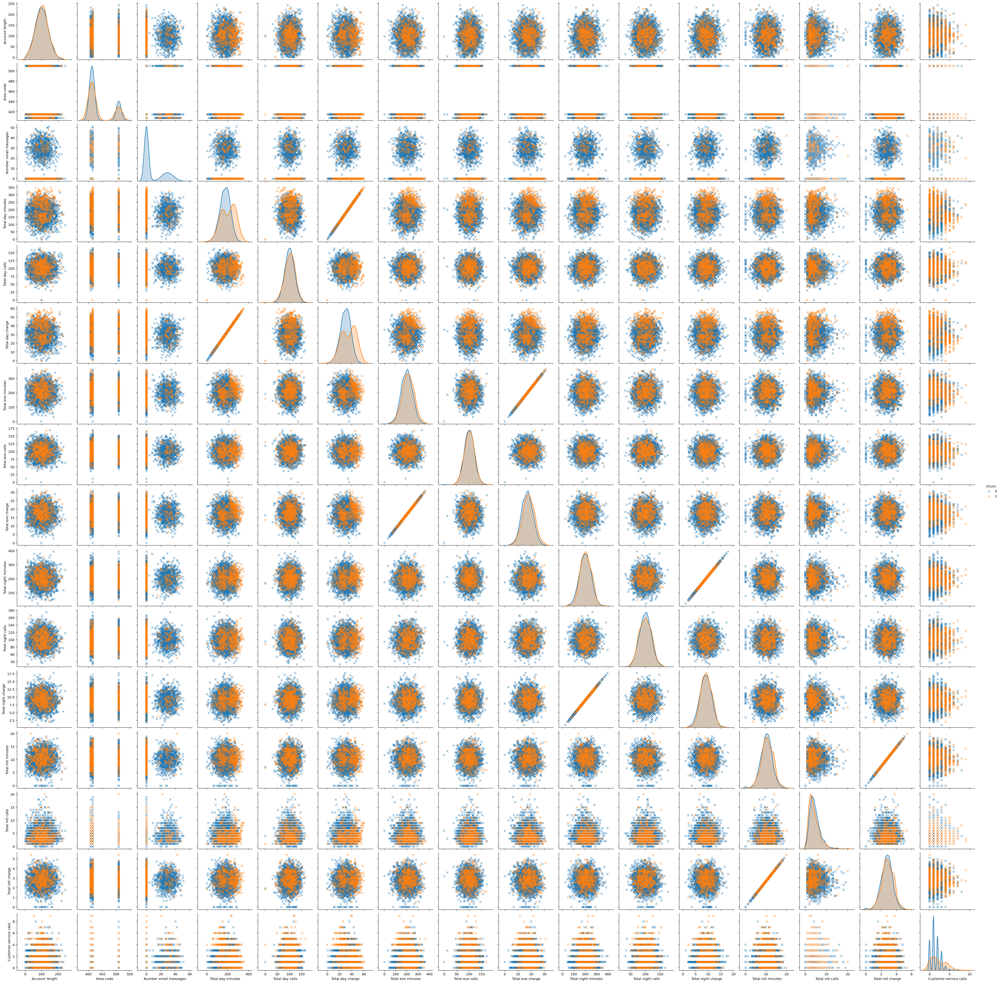

In [31]:
plt.figsize=(100, 100)
sns.pairplot(df, hue='Churn', markers='x')
plt.savefig('dist')
plt.show()

In [12]:
df.describe()

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856,0.144914
std,39.822106,42.371290,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491,0.352067
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000,0.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000,0.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000,0.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000,1.000000


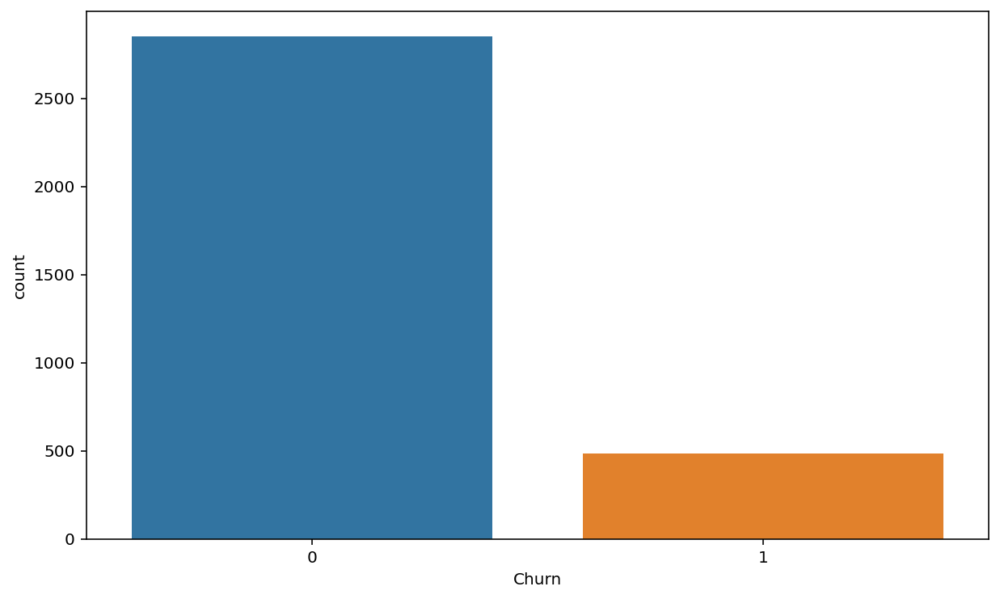

In [13]:
plt.figure(figsize = (10,6))
sns.countplot(data = df, x = 'Churn')
plt.show()

In [14]:
df.describe()

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856,0.144914
std,39.822106,42.371290,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491,0.352067
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000,0.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000,0.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000,0.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000,1.000000


In [17]:
dfX = pd.DataFrame(abs(df.corr()["Churn"].sort_values(ascending=False)))
dfX.head(10)

,Churn
Churn,1.000000
Customer service calls,0.208750
Total day minutes,0.205151
Total day charge,0.205151
Total eve minutes,0.092796
Total eve charge,0.092786
Total intl charge,0.068259
Total intl minutes,0.068239
Total night charge,0.035496
Total night minutes,0.035493


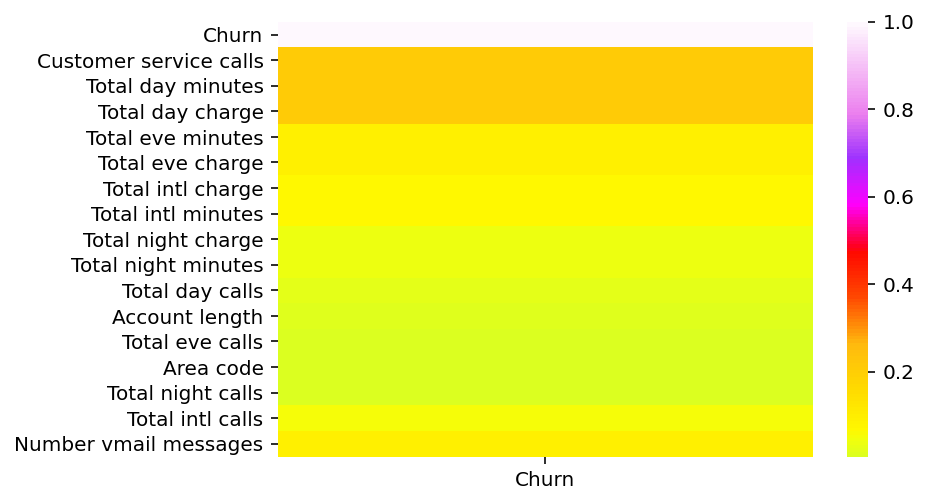

In [21]:
plt.figsize=(100, 100)
sns.heatmap(dfX, center=0, cmap='gist_ncar')
plt.show()

In [34]:
dfY = df[dfX[(dfX['Churn'] >= 0.2) & (dfX['Churn'] <= 0.8)].index]
dfY

,Customer service calls,Total day minutes,Total day charge
0,1,265.1,45.07
1,1,161.6,27.47
2,0,243.4,41.38
3,2,299.4,50.90
4,3,166.7,28.34
...,...,...,...
662,2,137.1,23.31
663,1,83.6,14.21
664,3,193.9,32.96
665,1,169.8,28.87


In [35]:
dfY["Churn"] = df["Churn"]
dfY

<ipython-input-35-3213b712ca6d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfY["Churn"] = df["Churn"]


,Customer service calls,Total day minutes,Total day charge,Churn
0,1,265.1,45.07,False
1,1,161.6,27.47,False
2,0,243.4,41.38,False
3,2,299.4,50.90,False
4,3,166.7,28.34,False
...,...,...,...,...
662,2,137.1,23.31,False
663,1,83.6,14.21,False
664,3,193.9,32.96,False
665,1,169.8,28.87,False


In [147]:
X = dfY.drop('Churn', axis=1)
y = dfY['Churn']

In [206]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X, y, test_size=0.33, random_state=42)

In [207]:
knn = KNeighborsClassifier(n_jobs=-1)
gnb = GaussianNB()
svc = SVC(random_state=42, degree=3)
lgc = LogisticRegression(random_state=42)
dcc = DecisionTreeClassifier(random_state=42, max_depth=6)
rfc = RandomForestClassifier(random_state=42, min_samples_leaf=30)
lda = LinearDiscriminantAnalysis()

estimators = [('K-nearest neighbors', knn),
              ('Naive Bayes classifier', gnb),
              ('Support vector machine', svc),
              ('Logistic Regression', lgc), 
              ('Decision tree', dcc),
              ('Random forest', rfc),
              ('Linear discriminant analysis', lda)]

In [208]:
def confusion_plot(label, y_valid, y_pred, ax=None):
    
    co_ma = confusion_matrix(y_valid, y_pred)
    groups = ['True Neg','False Pos','False Neg','True Pos']
    counts = [int(value) for value in co_ma.flatten()]
    shares = ['{0:.2%}'.format(value) for value in
             co_ma.flatten()/np.sum(co_ma)]
    labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
              zip(groups, counts, shares)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(co_ma, annot=labels, cmap='binary', alpha=.55, ax=ax,
             cbar=True, fmt='', linewidth=1, linecolor='black')
    plt.title(f'Confusion Matrix for {label}')


In [209]:
def create_metrics(X_train, X_valid, y_train, y_valid):
    metrics = []
    for est in estimators:

        fig, axes = plt.subplots(ncols=3, figsize=(15,4))

        mod = est[1].fit(X_train, y_train)
        y_pred = mod.predict(X_valid)
        plot_precision_recall_curve(mod, X_valid, y_valid, 
                        y_pred, ax=axes[0], color='black')
        plot_roc_curve(mod, X_valid, y_valid, ax = axes[1], color='black')

        axes[0].set_title(f'Precision-Recall Curve for {est[0]}')
        axes[1].set_title(f'ROC Curve for {est[0]}')
        axes[1].plot([1,0], [1,0], c='green', ls='--')
        confusion_plot(est[0], y_valid, y_pred, axes[2])

        scores = {}
        scores['classifier'] = est[0]
        scores['accuracy_score'] = accuracy_score(y_valid, y_pred)
        scores['roc_auc_score'] = roc_auc_score(y_valid, y_pred)
        scores['f1_score'] = f1_score(y_valid, y_pred)
        scores['recall_score'] = recall_score(y_valid, y_pred)
        scores['precision_score'] = precision_score(y_valid, y_pred)

        plt.tight_layout()
        metrics.append(scores)
        plt.savefig('graph_' + str(est[0]))
    return pd.DataFrame(metrics)

        

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.868182,0.625490,0.388186,0.278788,0.638889
1,Naive Bayes classifier,0.853636,0.691800,0.485623,0.460606,0.513514
2,Support vector machine,0.856364,0.531194,0.122222,0.066667,0.733333
3,Logistic Regression,0.854545,0.550089,0.191919,0.115152,0.575758
4,Decision tree,0.880909,0.685383,0.505660,0.406061,0.670000
5,Random forest,0.886364,0.683601,0.509804,0.393939,0.722222
6,Linear discriminant analysis,0.857273,0.591622,0.308370,0.212121,0.564516


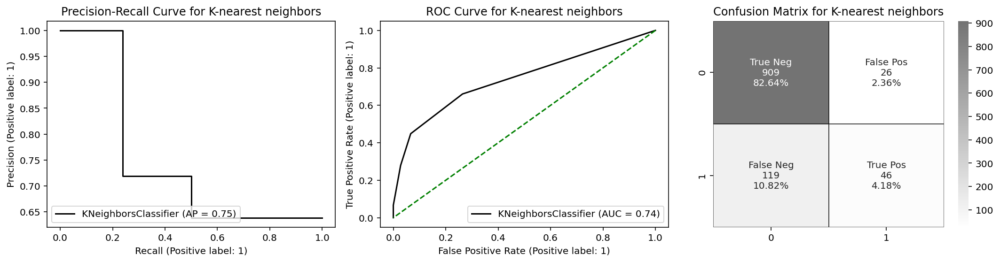

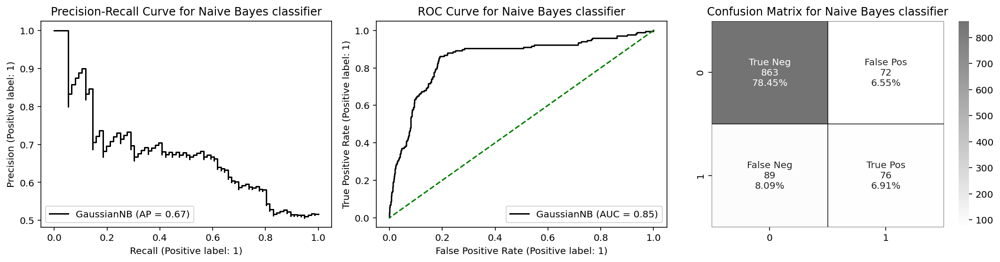

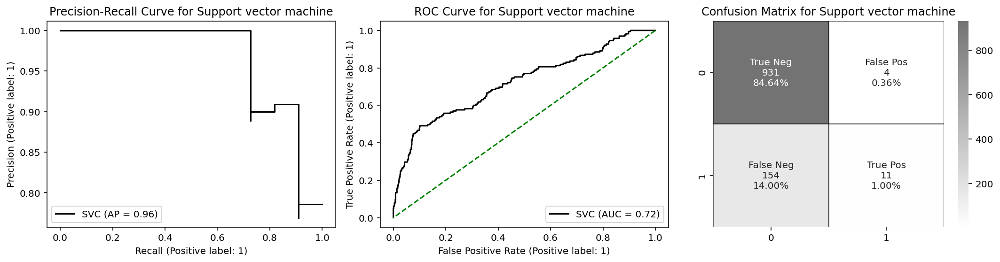

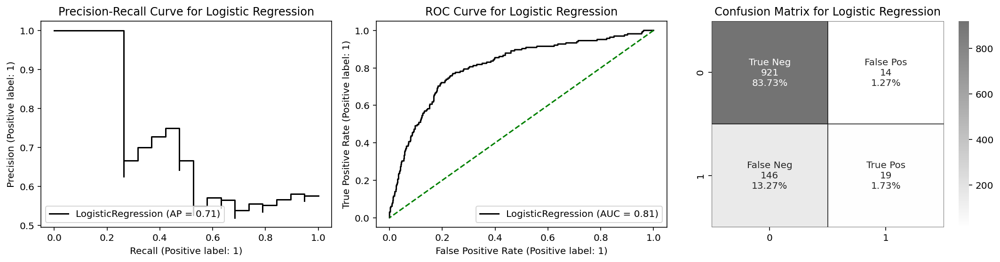

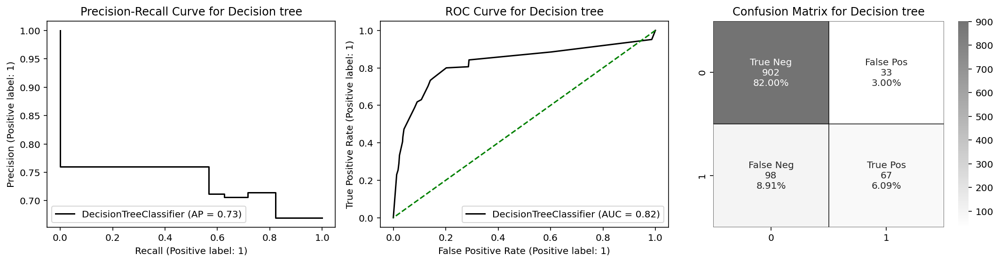

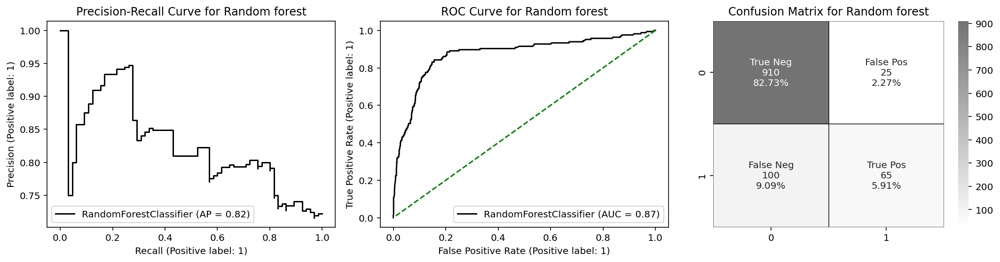

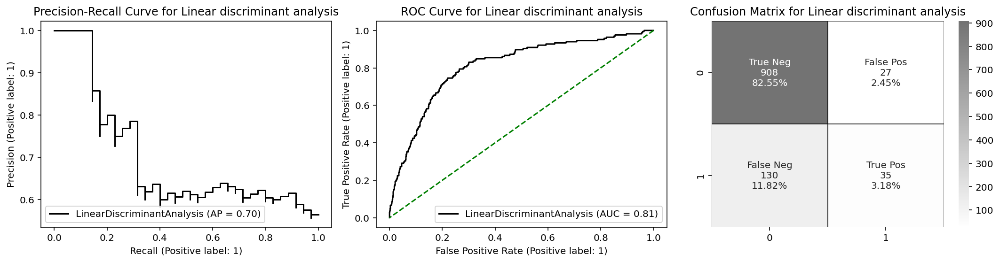

In [210]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [211]:
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X, y)

<AxesSubplot:ylabel='Churn'>

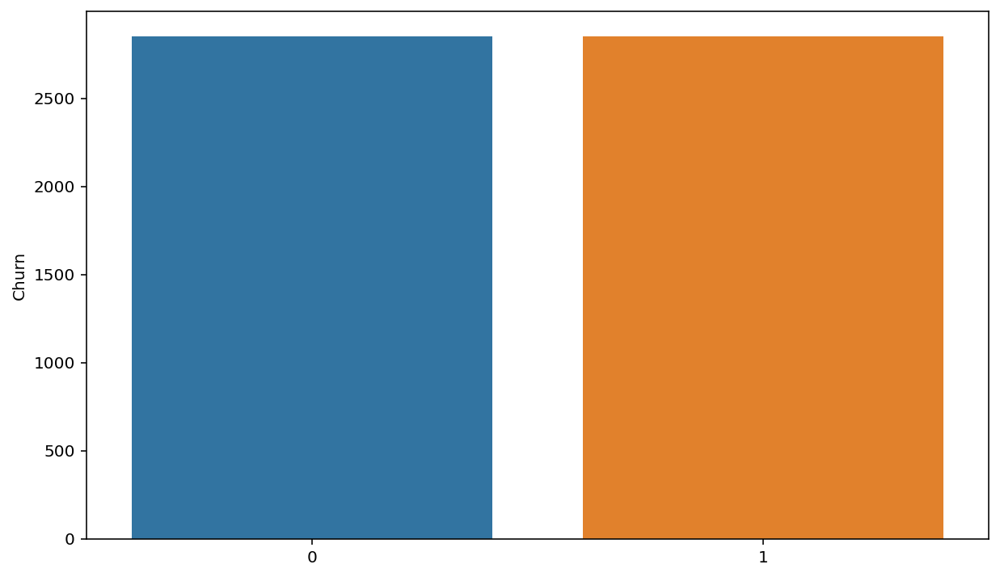

In [212]:
plt.figure(figsize = (10,6))
sns.barplot(x=y_resampled.value_counts().index, y=y_resampled.value_counts())

In [213]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_resampled, y_resampled, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.848485,0.850283,0.858279,0.937025,0.791743
1,Naive Bayes classifier,0.765019,0.763660,0.744213,0.698154,0.796778
2,Support vector machine,0.654971,0.649673,0.528000,0.394137,0.799559
3,Logistic Regression,0.743753,0.743753,0.739741,0.743757,0.735768
4,Decision tree,0.833068,0.833746,0.835602,0.866450,0.806876
5,Random forest,0.828283,0.828705,0.828829,0.849077,0.809524
6,Linear discriminant analysis,0.743222,0.743078,0.737357,0.736156,0.738562


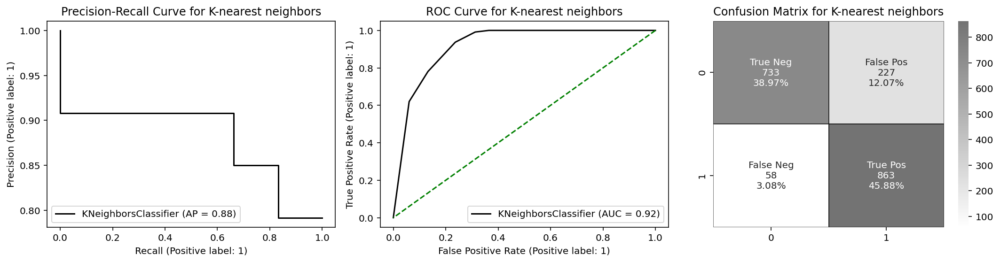

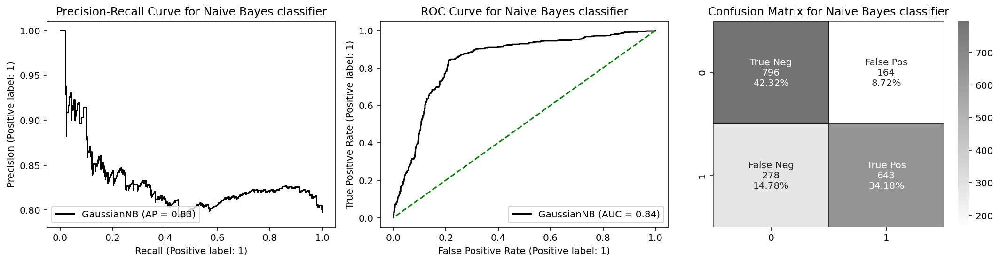

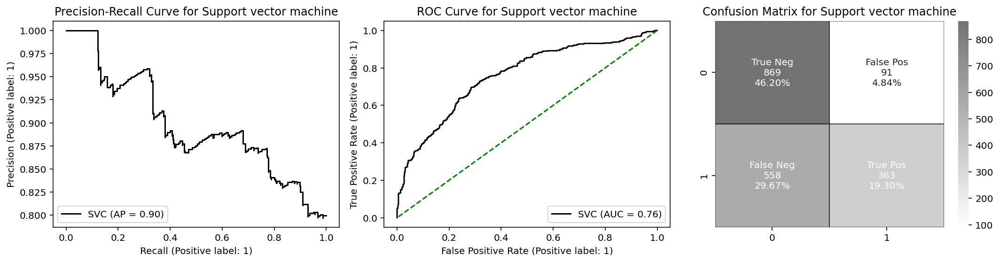

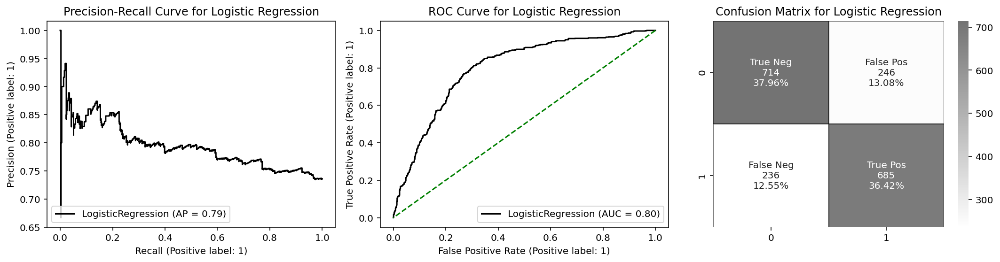

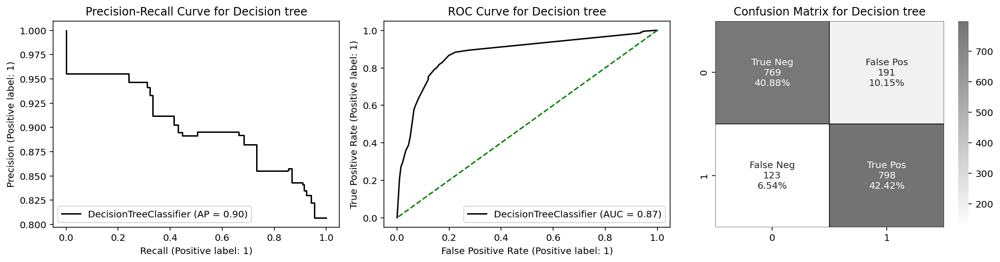

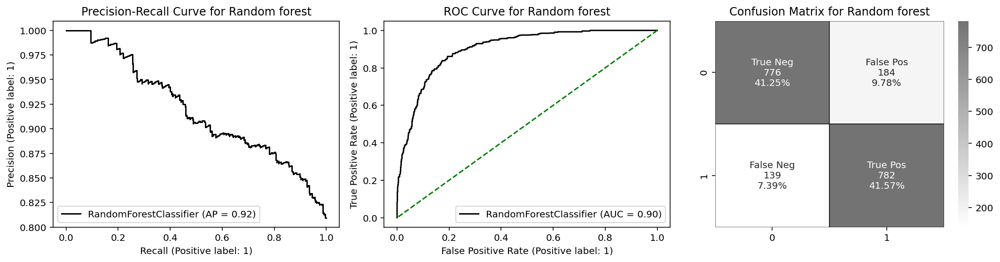

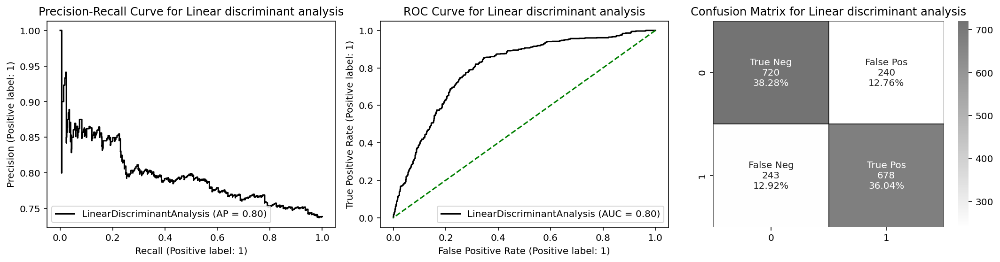

In [214]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [215]:
from imblearn.over_sampling import SMOTE, ADASYN
X_resampled_smote, y_resampled_smote = SMOTE().fit_resample(X, y)

<AxesSubplot:ylabel='Churn'>

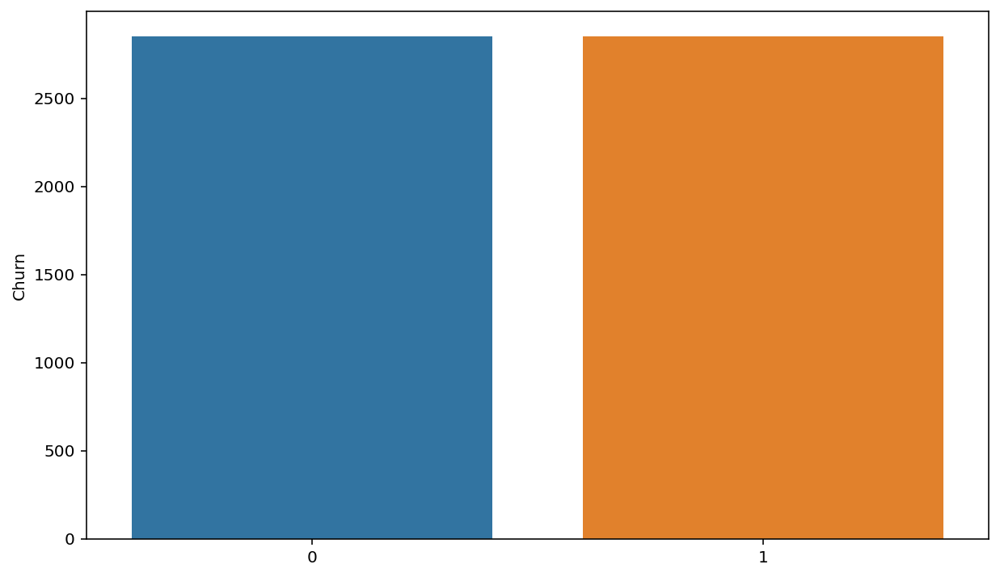

In [216]:
plt.figure(figsize = (10,6))
sns.barplot(x=y_resampled_smote.value_counts().index, y=y_resampled_smote.value_counts())

In [218]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_resampled_smote, y_resampled_smote, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.805954,0.806499,0.807794,0.832790,0.784254
1,Naive Bayes classifier,0.724083,0.722784,0.700865,0.660152,0.746929
2,Support vector machine,0.659755,0.654603,0.538905,0.406080,0.800857
3,Logistic Regression,0.696970,0.697567,0.701258,0.726384,0.677812
4,Decision tree,0.796385,0.795228,0.780516,0.739414,0.826456
5,Random forest,0.790005,0.789507,0.781163,0.765472,0.797511
6,Linear discriminant analysis,0.695375,0.696027,0.700470,0.727470,0.675403


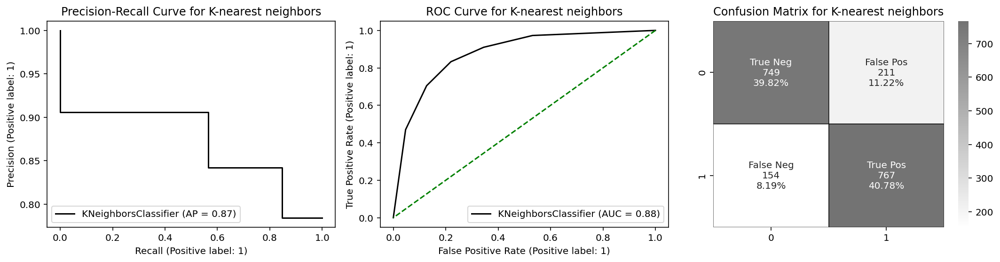

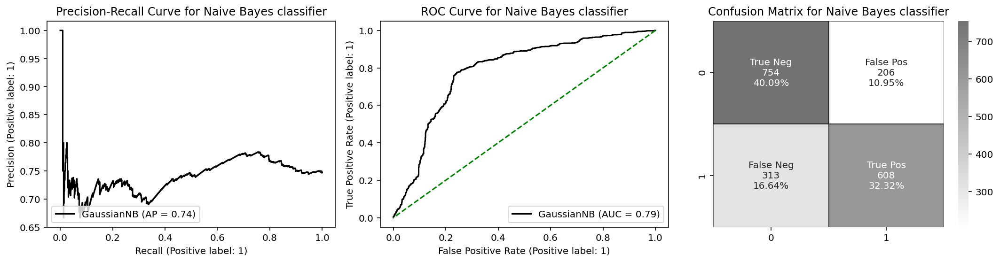

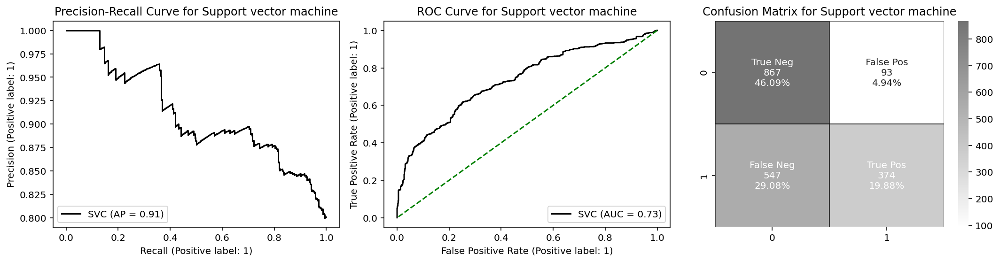

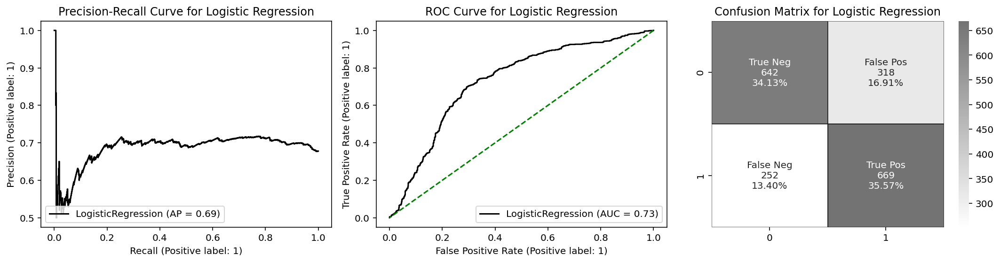

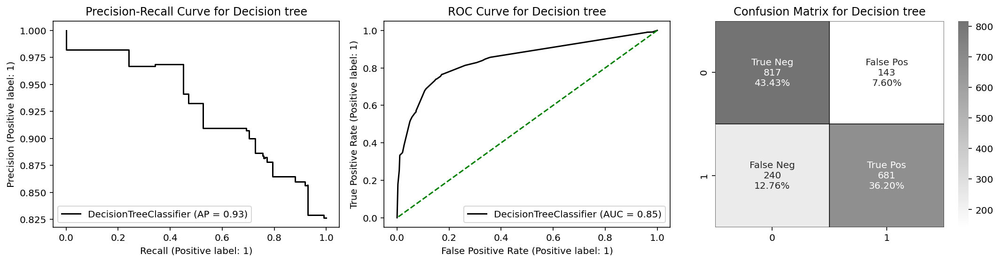

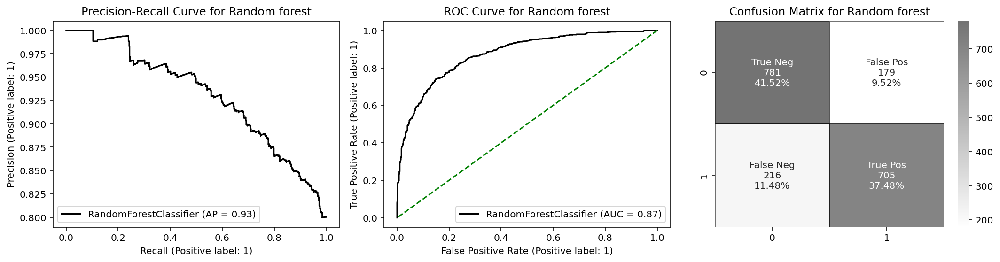

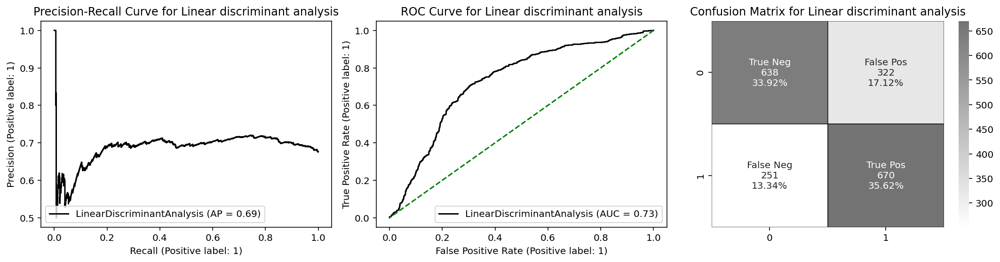

In [219]:
create_metrics(X_train, X_valid, y_train, y_valid)


In [220]:
X_resampled_adasyn, y_resampled_adasyn = ADASYN().fit_resample(X, y)

In [221]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_resampled_adasyn, y_resampled_adasyn, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.780238,0.781487,0.779881,0.811937,0.750260
1,Naive Bayes classifier,0.693305,0.688703,0.643216,0.576577,0.727273
2,Support vector machine,0.636609,0.627140,0.511256,0.396396,0.719836
3,Logistic Regression,0.656048,0.655356,0.640316,0.638514,0.642129
4,Decision tree,0.741901,0.738447,0.708537,0.654279,0.772606
5,Random forest,0.743521,0.741912,0.724318,0.702703,0.747305
6,Linear discriminant analysis,0.650648,0.650214,0.637128,0.639640,0.634637


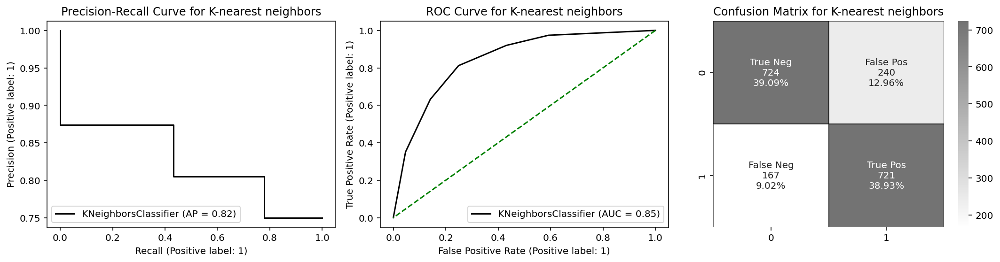

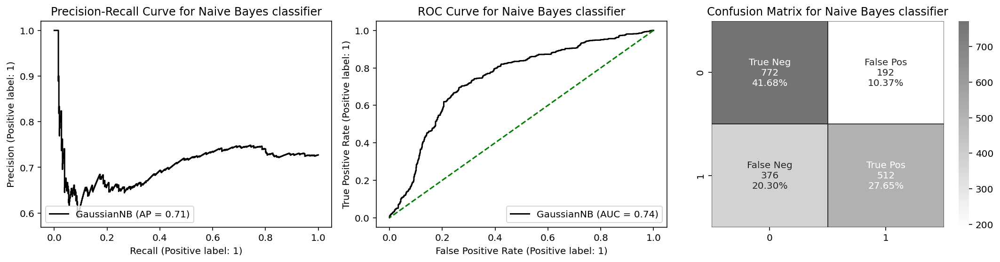

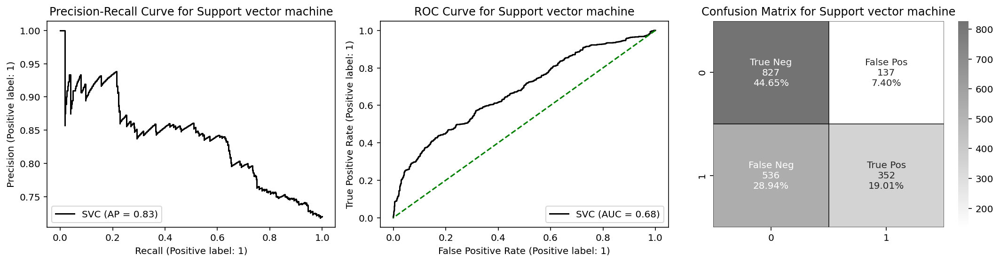

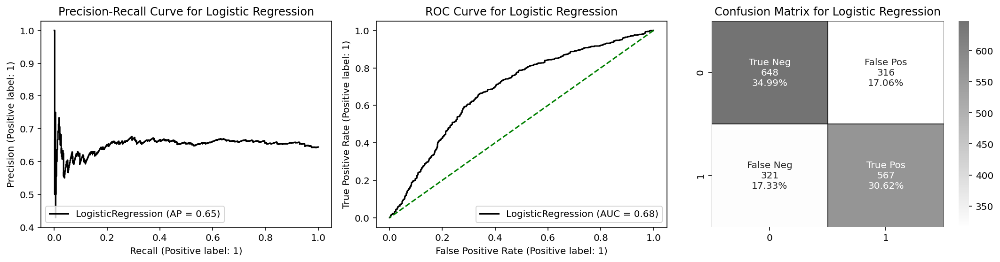

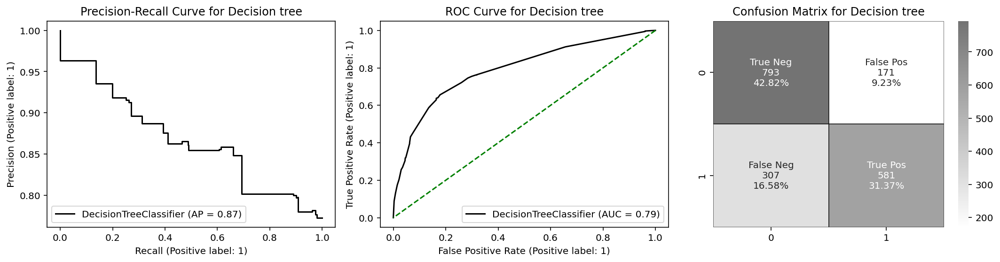

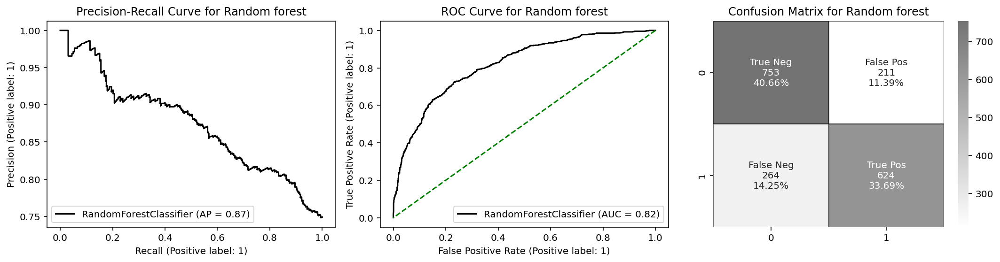

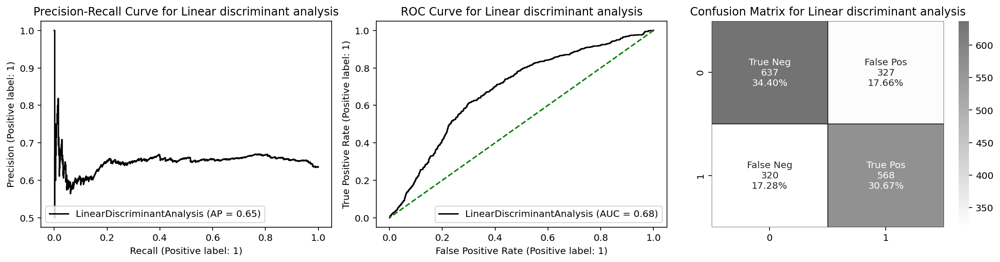

In [222]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [223]:
from imblearn.under_sampling import RandomUnderSampler
rus = RandomUnderSampler(random_state=0)
X_u_resampled, y_u_resampled = rus.fit_resample(X, y)

<AxesSubplot:ylabel='Churn'>

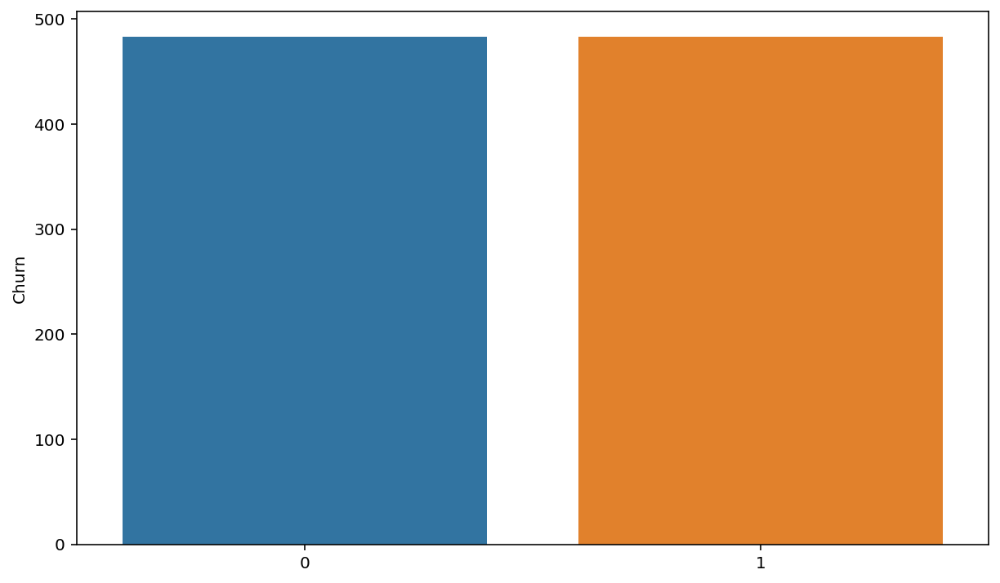

In [224]:
plt.figure(figsize = (10,6))
sns.barplot(x=y_u_resampled.value_counts().index, y=y_u_resampled.value_counts())

In [225]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_u_resampled, y_u_resampled, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.683386,0.682620,0.652921,0.601266,0.714286
1,Naive Bayes classifier,0.736677,0.736182,0.720000,0.683544,0.760563
2,Support vector machine,0.626959,0.624833,0.514286,0.398734,0.724138
3,Logistic Regression,0.727273,0.727455,0.730650,0.746835,0.715152
4,Decision tree,0.777429,0.777321,0.773163,0.765823,0.780645
5,Random forest,0.783699,0.784004,0.788991,0.816456,0.763314
6,Linear discriminant analysis,0.717868,0.717902,0.716981,0.721519,0.712500


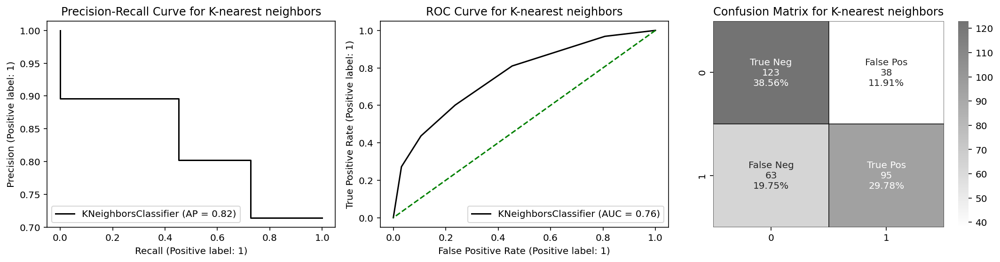

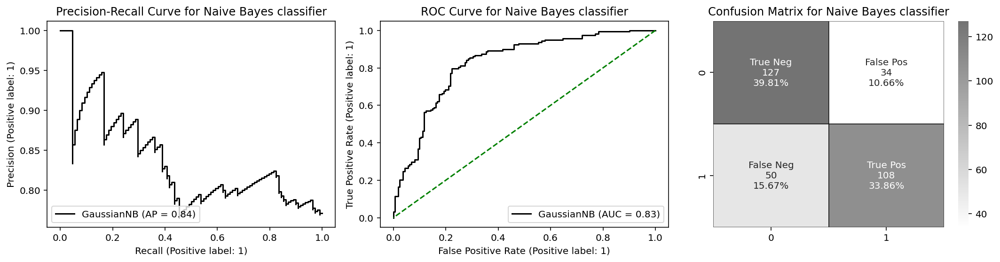

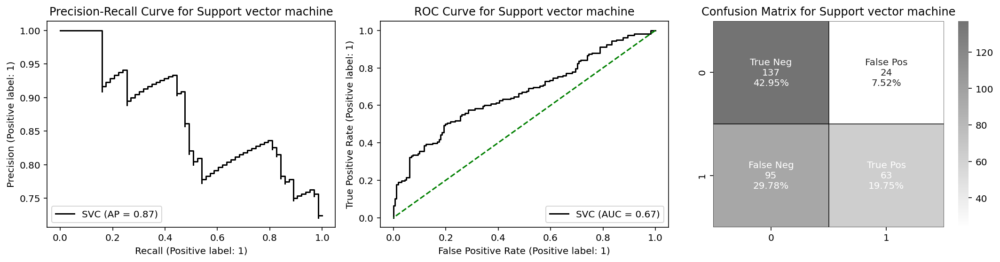

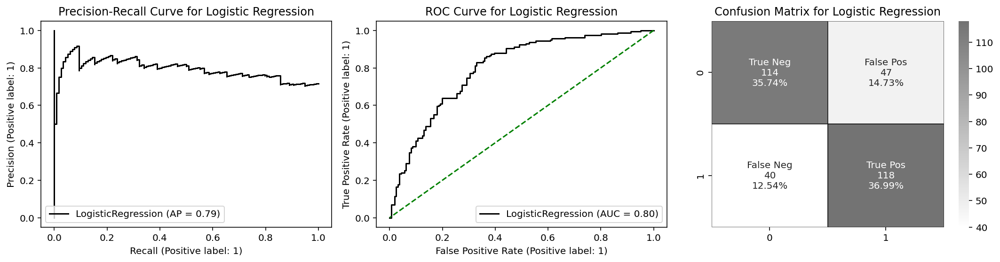

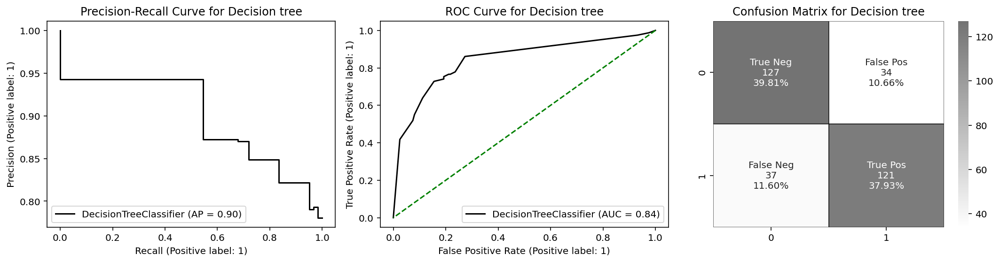

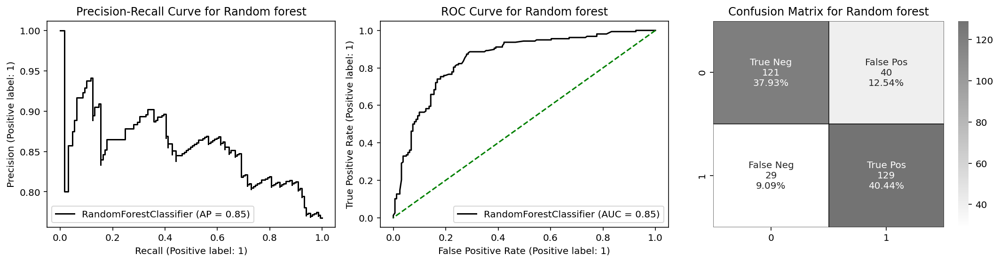

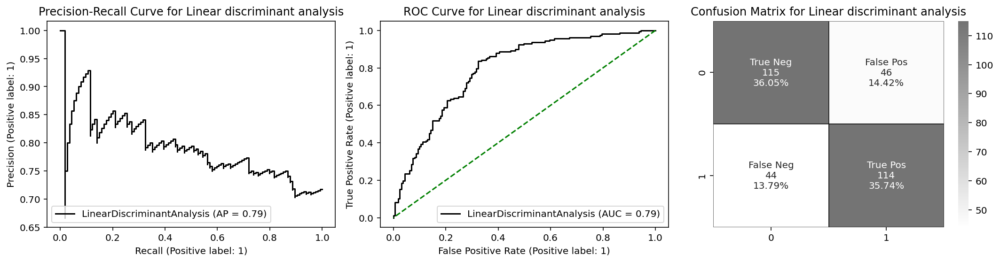

In [226]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [227]:
from imblearn.under_sampling import ClusterCentroids
cc = ClusterCentroids(random_state=0)
X_c_resampled, y_c_resampled = cc.fit_resample(X, y)

In [228]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_c_resampled, y_c_resampled, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.645768,0.645589,0.636656,0.626582,0.647059
1,Naive Bayes classifier,0.648903,0.646454,0.521368,0.386076,0.802632
2,Support vector machine,0.608150,0.606199,0.501992,0.398734,0.677419
3,Logistic Regression,0.752351,0.751887,0.737542,0.702532,0.776224
4,Decision tree,0.777429,0.776732,0.757679,0.702532,0.822222
5,Random forest,0.786834,0.787051,0.790123,0.810127,0.771084
6,Linear discriminant analysis,0.739812,0.738993,0.712803,0.651899,0.786260


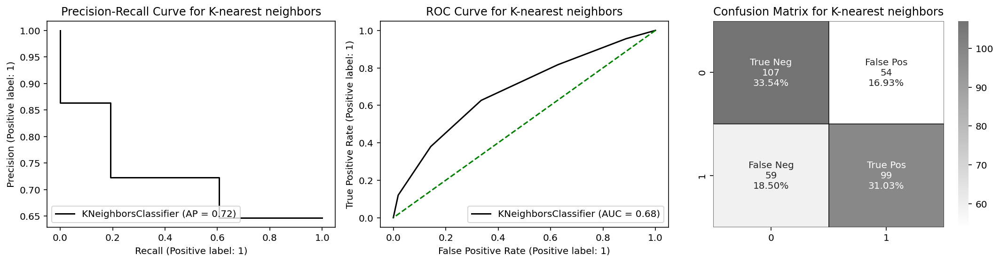

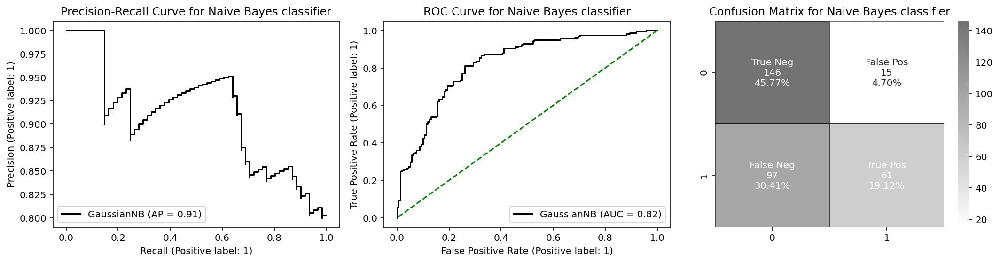

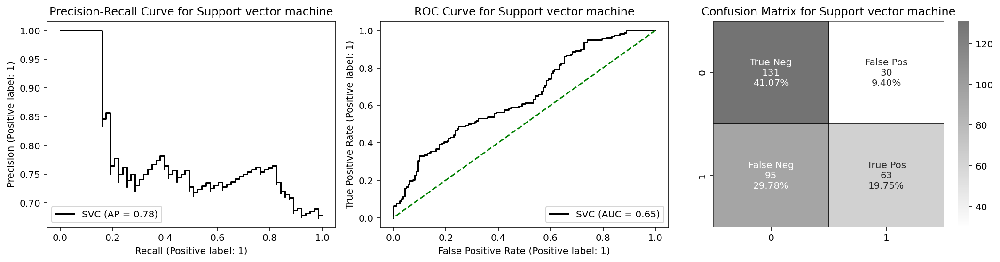

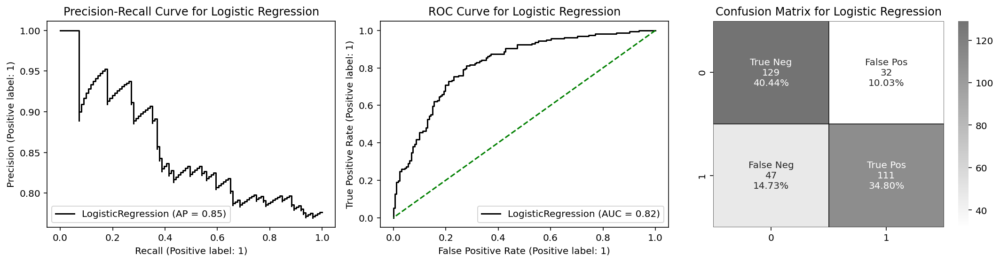

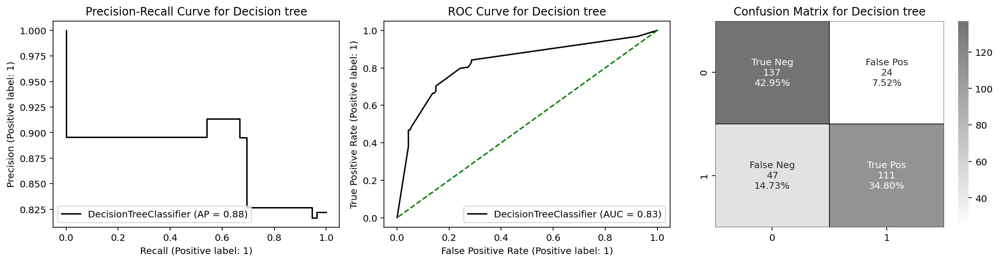

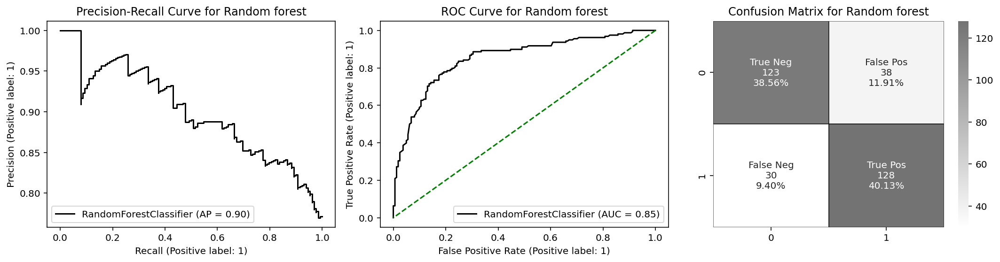

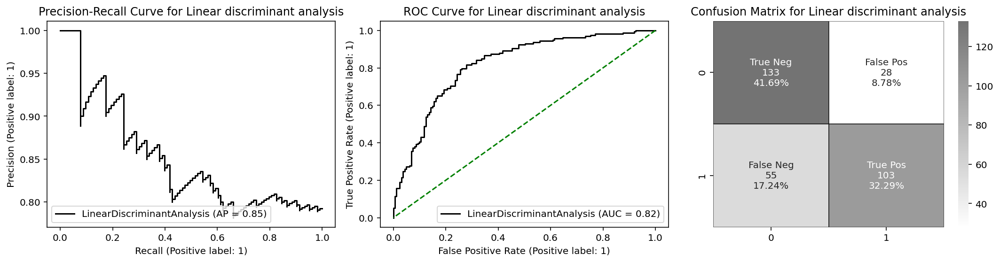

In [229]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [230]:
from imblearn.under_sampling import TomekLinks 
tl = TomekLinks()
X_tl_resampled, y_tl_resampled = tl.fit_resample(X, y)

In [231]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_tl_resampled, y_tl_resampled, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.866604,0.632344,0.405063,0.292683,0.657534
1,Naive Bayes classifier,0.855251,0.675402,0.470588,0.414634,0.544000
2,Support vector machine,0.853359,0.534906,0.134078,0.073171,0.800000
3,Logistic Regression,0.844844,0.559733,0.226415,0.146341,0.500000
4,Decision tree,0.888363,0.707443,0.553030,0.445122,0.730000
5,Random forest,0.887417,0.704395,0.547529,0.439024,0.727273
6,Linear discriminant analysis,0.846736,0.593208,0.313559,0.225610,0.513889


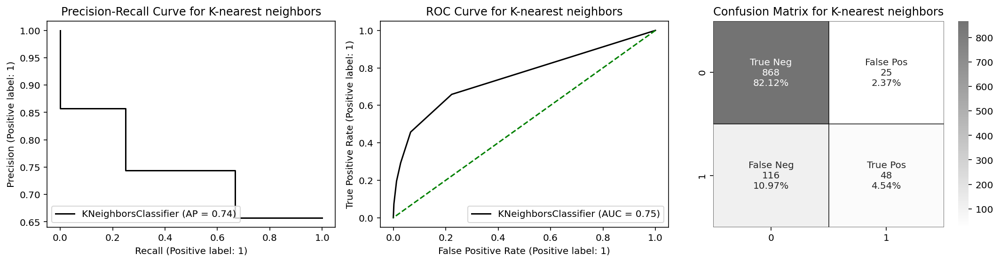

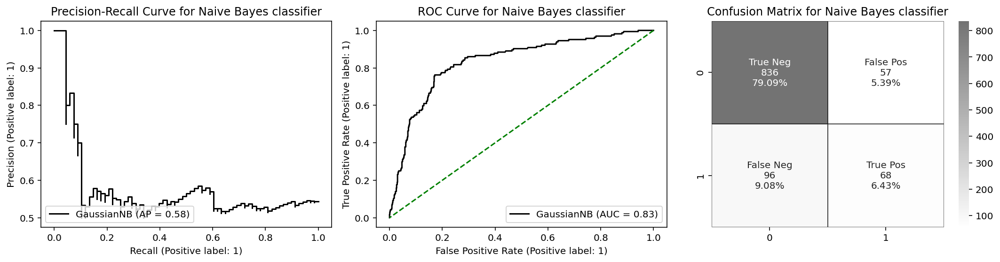

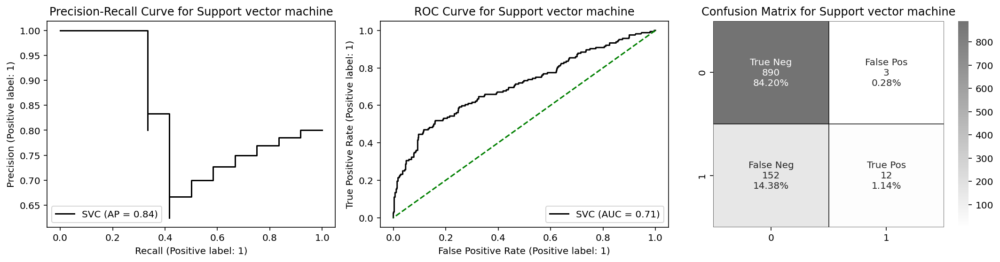

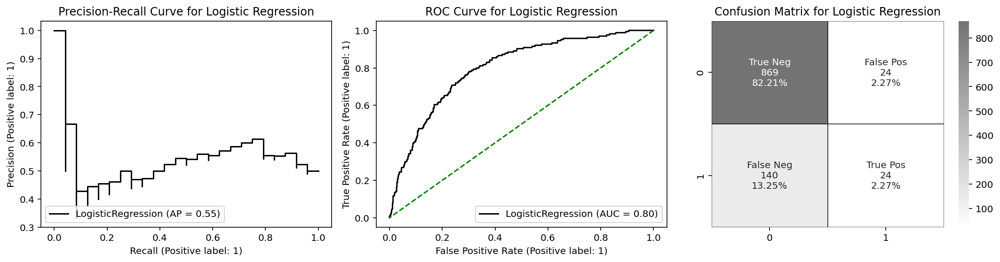

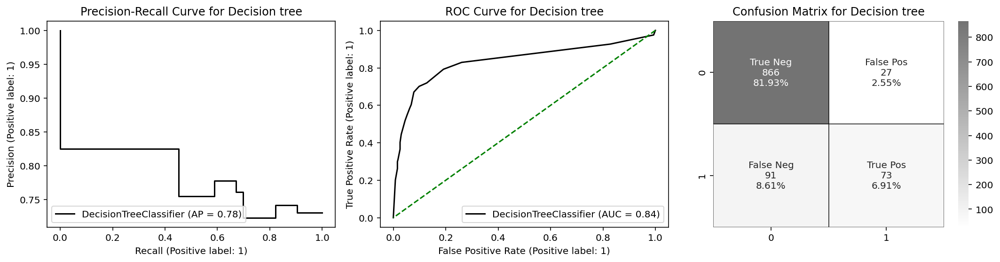

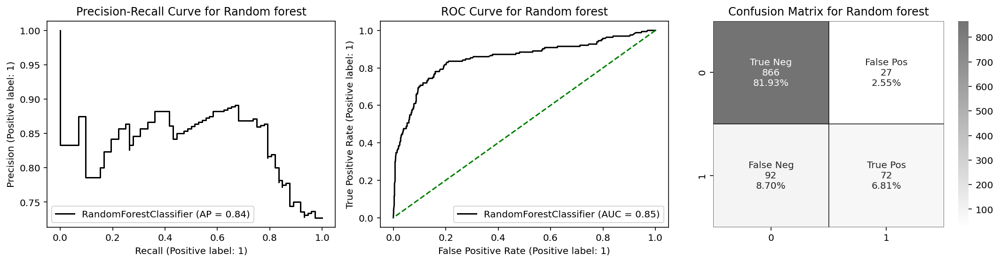

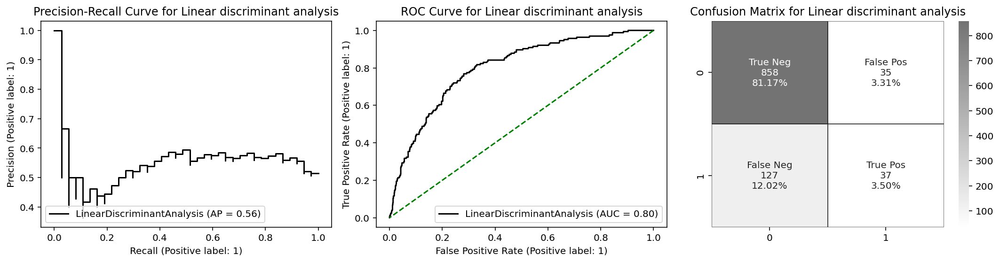

In [232]:
create_metrics(X_train, X_valid, y_train, y_valid)

In [233]:
from imblearn.combine import SMOTETomek
smote_tomek = SMOTETomek(random_state=0)
X_resampled_smote_tomek, y_resampled_smote_tomek = smote_tomek.fit_resample(X, y)

In [234]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X_resampled_smote_tomek, y_resampled_smote_tomek, test_size=0.33, random_state=42)

,classifier,accuracy_score,roc_auc_score,f1_score,recall_score,precision_score
0,K-nearest neighbors,0.807585,0.807499,0.803866,0.802497,0.805239
1,Naive Bayes classifier,0.709426,0.707477,0.667941,0.594779,0.761628
2,Support vector machine,0.639152,0.634308,0.490952,0.354143,0.800000
3,Logistic Regression,0.712772,0.712599,0.706218,0.702611,0.709862
4,Decision tree,0.793084,0.791817,0.773366,0.718502,0.837302
5,Random forest,0.789180,0.788307,0.774732,0.737798,0.815558
6,Linear discriminant analysis,0.712772,0.712599,0.706218,0.702611,0.709862


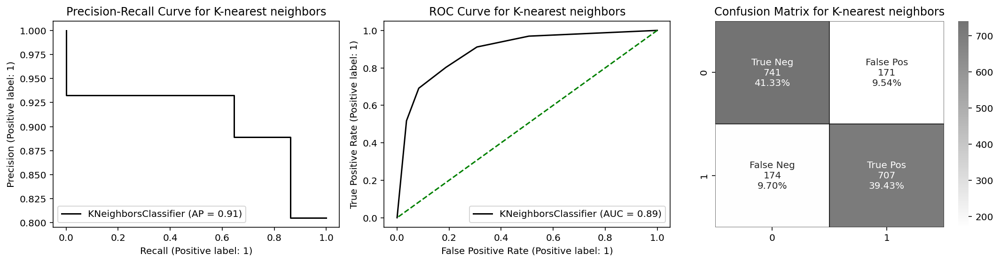

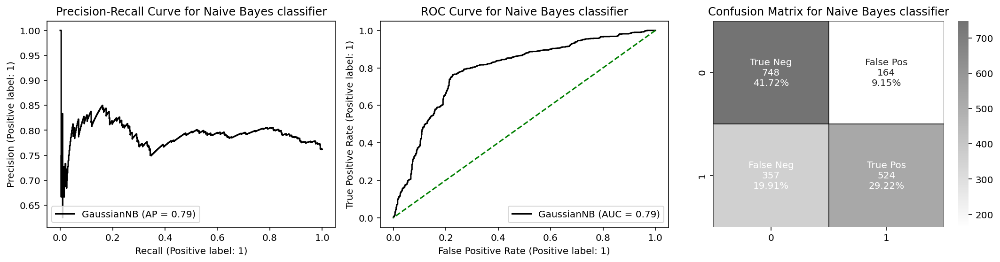

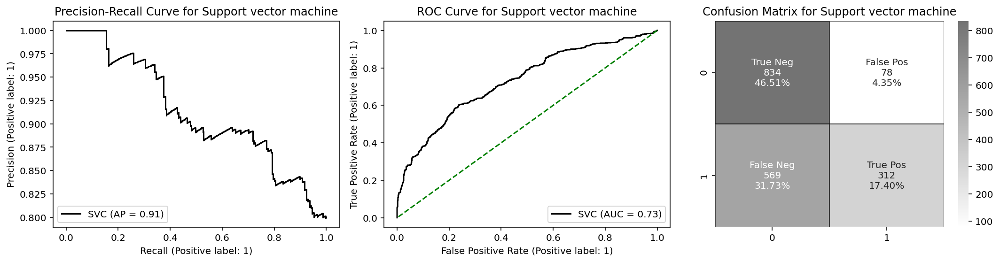

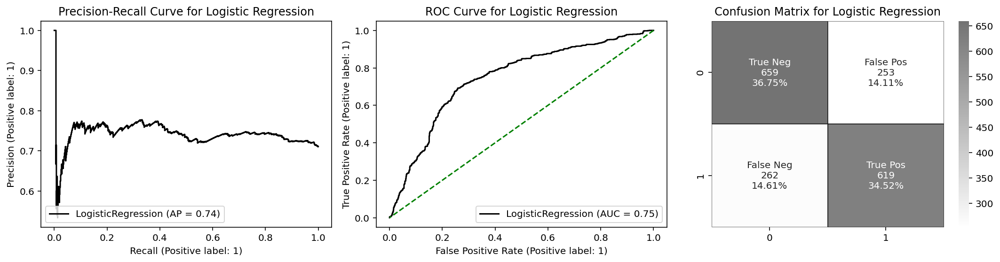

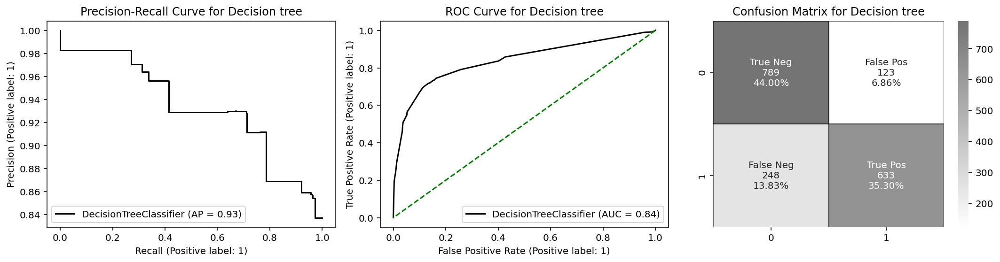

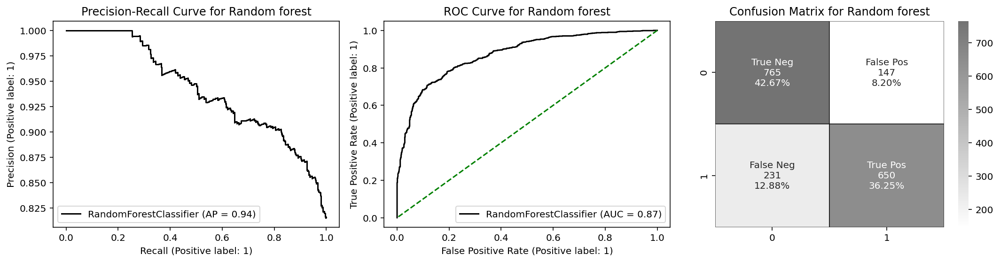

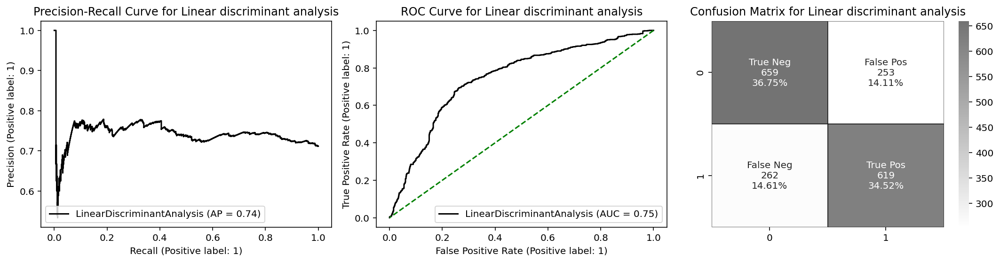

In [235]:
create_metrics(X_train, X_valid, y_train, y_valid)

,classifier,accuracy_score,ROC AUC score,f1_score,recall_score,precision_score
0,Bagging Classifier,0.860909,0.681105,0.477816,0.424242,0.546875


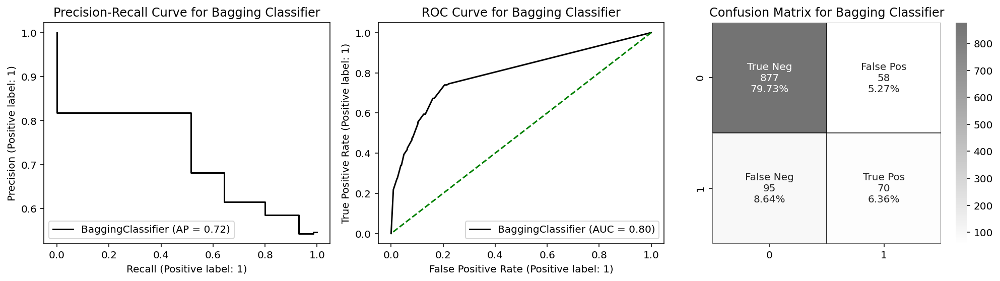

In [236]:
from sklearn.ensemble import BaggingClassifier


X_train, X_valid, y_train, y_valid = train_test_split(
    X, y, test_size=0.33, random_state=42)

stacked_metrics={}

reg = BaggingClassifier()
cls_name = 'Bagging Classifier'

regmodel = reg.fit(X_train, y_train)
y_pred = reg.predict(X_valid)

fig, axes = plt.subplots(ncols=3, figsize=(14,4))

plot_precision_recall_curve(regmodel,X_valid,y_valid, 
            y_pred, color='black', ax=axes[0])
plot_roc_curve(regmodel,X_valid,y_valid, 
               color='black', ax=axes[1])

axes[0].set_title(f'Precision-Recall Curve for {cls_name}')
axes[1].plot([1,0],[1,0], c='green',ls='--')
axes[1].set_title(f'ROC Curve for {cls_name}')
confusion_plot(cls_name,y_valid, y_pred, axes[2])

stacked_metrics['classifier'] = cls_name
stacked_metrics['accuracy_score'] = accuracy_score(y_valid, y_pred)
stacked_metrics['ROC AUC score'] = roc_auc_score(y_valid, y_pred)
stacked_metrics['f1_score'] = f1_score(y_valid, y_pred)
stacked_metrics['recall_score'] = recall_score(y_valid, y_pred)
stacked_metrics['precision_score'] = precision_score(y_valid, y_pred)
    
plt.tight_layout()

pd.DataFrame([stacked_metrics])

,classifier,accuracy_score,ROC AUC score,f1_score,recall_score,precision_score
0,Easy Ensemble Classifier,0.845455,0.824242,0.606481,0.793939,0.490637


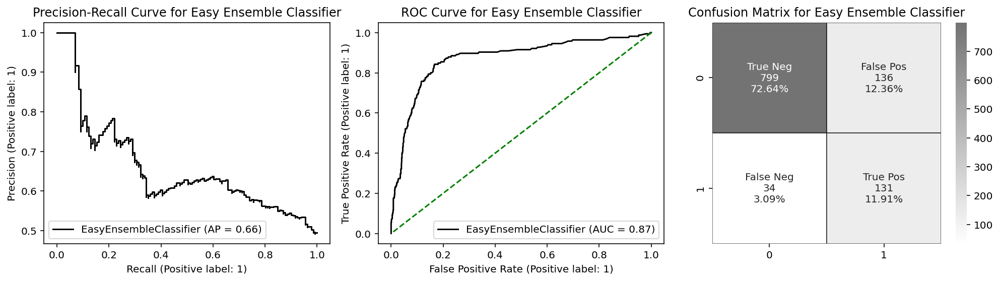

In [237]:
from imblearn.ensemble import EasyEnsembleClassifier

X_train, X_valid, y_train, y_valid = train_test_split(
    X, y, test_size=0.33, random_state=42)

stacked_metrics={}

eec = EasyEnsembleClassifier()
cls_name = 'Easy Ensemble Classifier'

regmodel = eec.fit(X_train, y_train)
y_pred = eec.predict(X_valid)

fig, axes = plt.subplots(ncols=3, figsize=(14,4))

plot_precision_recall_curve(regmodel,X_valid,y_valid, 
            y_pred, color='black', ax=axes[0])
plot_roc_curve(regmodel,X_valid,y_valid, 
               color='black', ax=axes[1])

axes[0].set_title(f'Precision-Recall Curve for {cls_name}')
axes[1].plot([1,0],[1,0], c='green',ls='--')
axes[1].set_title(f'ROC Curve for {cls_name}')
confusion_plot(cls_name,y_valid, y_pred, axes[2])

stacked_metrics['classifier'] = cls_name
stacked_metrics['accuracy_score'] = accuracy_score(y_valid, y_pred)
stacked_metrics['ROC AUC score'] = roc_auc_score(y_valid, y_pred)
stacked_metrics['f1_score'] = f1_score(y_valid, y_pred)
stacked_metrics['recall_score'] = recall_score(y_valid, y_pred)
stacked_metrics['precision_score'] = precision_score(y_valid, y_pred)
    
plt.tight_layout()

pd.DataFrame([stacked_metrics])

,classifier,accuracy_score,ROC AUC score,f1_score,recall_score,precision_score
0,Ada Boost Classifier,0.860909,0.603743,0.337662,0.236364,0.590909


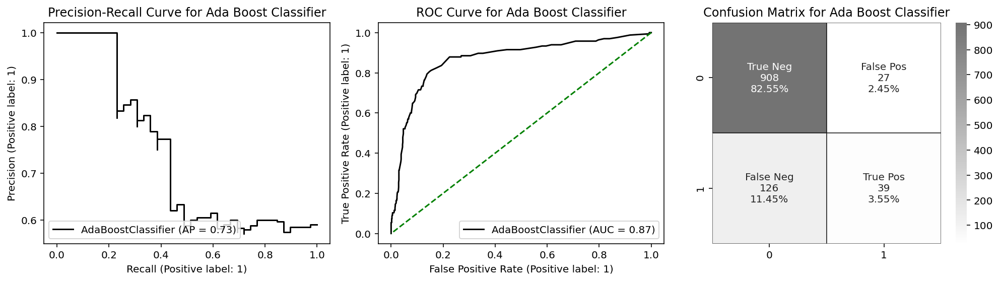

In [238]:
from sklearn.ensemble import AdaBoostClassifier

X_train, X_valid, y_train, y_valid = train_test_split(
    X, y, test_size=0.33, random_state=42)

stacked_metrics={}

abc = AdaBoostClassifier()
cls_name = 'Ada Boost Classifier'

regmodel = abc.fit(X_train, y_train)
y_pred = abc.predict(X_valid)

fig, axes = plt.subplots(ncols=3, figsize=(14,4))

plot_precision_recall_curve(regmodel,X_valid,y_valid, 
            y_pred, color='black', ax=axes[0])
plot_roc_curve(regmodel,X_valid,y_valid, 
               color='black', ax=axes[1])

axes[0].set_title(f'Precision-Recall Curve for {cls_name}')
axes[1].plot([1,0],[1,0], c='green',ls='--')
axes[1].set_title(f'ROC Curve for {cls_name}')
confusion_plot(cls_name,y_valid, y_pred, axes[2])

stacked_metrics['classifier'] = cls_name
stacked_metrics['accuracy_score'] = accuracy_score(y_valid, y_pred)
stacked_metrics['ROC AUC score'] = roc_auc_score(y_valid, y_pred)
stacked_metrics['f1_score'] = f1_score(y_valid, y_pred)
stacked_metrics['recall_score'] = recall_score(y_valid, y_pred)
stacked_metrics['precision_score'] = precision_score(y_valid, y_pred)
    
plt.tight_layout()

pd.DataFrame([stacked_metrics])

In [239]:
from collections import Counter

import numpy as np
from sklearn.base import is_regressor
from sklearn.ensemble import AdaBoostClassifier
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import normalize
from sklearn.utils import check_random_state
from sklearn.utils import check_X_y
#from sklearn.utils import shuffle


class SMOTE(object):
    """Implementation of Synthetic Minority Over-Sampling Technique (SMOTE).
    SMOTE performs oversampling of the minority class by picking target 
    minority class samples and their nearest minority class neighbors and 
    generating new samples that linearly combine features of each target 
    sample with features of its selected minority class neighbors [1].
    Parameters
    ----------
    k_neighbors : int, optional (default=5)
        Number of nearest neighbors.
    random_state : int or None, optional (default=None)
        If int, random_state is the seed used by the random number generator.
        If None, the random number generator is the RandomState instance used
        by np.random.
    References
    ----------
    .. [1] N. V. Chawla, K. W. Bowyer, L. O. Hall, and P. Kegelmeyer. "SMOTE:
           Synthetic Minority Over-Sampling Technique." Journal of Artificial
           Intelligence Research (JAIR), 2002.
    """

    def __init__(self, k_neighbors=5, random_state=None):
        self.k = k_neighbors
        self.random_state = random_state

    def sample(self, n_samples):
        """Generate samples.
        Parameters
        ----------
        n_samples : int
            Number of new synthetic samples.
        Returns
        -------
        S : array, shape = [n_samples, n_features]
            Returns synthetic samples.
        """
        np.random.seed(seed=self.random_state)

        S = np.zeros(shape=(n_samples, self.n_features))
        # Calculate synthetic samples.
        for i in range(n_samples):
            j = np.random.randint(0, self.X.shape[0])

            # Find the NN for each sample.
            # Exclude the sample itself.
            nn = self.neigh.kneighbors(self.X[j].reshape(1, -1),
                                       return_distance=False)[:, 1:]
            nn_index = np.random.choice(nn[0])

            dif = self.X[nn_index] - self.X[j]
            gap = np.random.random()

            S[i, :] = self.X[j, :] + gap * dif[:]

        return S

    def fit(self, X):
        """Train model based on input data.
        Parameters
        ----------
        X : array-like, shape = [n_minority_samples, n_features]
            Holds the minority samples.
        """
        self.X = X
        self.n_minority_samples, self.n_features = self.X.shape

        # Learn nearest neighbors.
        self.neigh = NearestNeighbors(n_neighbors=self.k + 1)
        self.neigh.fit(self.X)

        return self


class SMOTEBoost(AdaBoostClassifier):
    """Implementation of SMOTEBoost.
    SMOTEBoost introduces data sampling into the AdaBoost algorithm by
    oversampling the minority class using SMOTE on each boosting iteration [1].
    This implementation inherits methods from the scikit-learn 
    AdaBoostClassifier class, only modifying the `fit` method.
    Parameters
    ----------
    n_samples : int, optional (default=100)
        Number of new synthetic samples per boosting step.
    k_neighbors : int, optional (default=5)
        Number of nearest neighbors.
    base_estimator : object, optional (default=DecisionTreeClassifier)
        The base estimator from which the boosted ensemble is built.
        Support for sample weighting is required, as well as proper `classes_`
        and `n_classes_` attributes.
    n_estimators : int, optional (default=50)
        The maximum number of estimators at which boosting is terminated.
        In case of perfect fit, the learning procedure is stopped early.
    learning_rate : float, optional (default=1.)
        Learning rate shrinks the contribution of each classifier by
        ``learning_rate``. There is a trade-off between ``learning_rate`` and
        ``n_estimators``.
    algorithm : {'SAMME', 'SAMME.R'}, optional (default='SAMME.R')
        If 'SAMME.R' then use the SAMME.R real boosting algorithm.
        ``base_estimator`` must support calculation of class probabilities.
        If 'SAMME' then use the SAMME discrete boosting algorithm.
        The SAMME.R algorithm typically converges faster than SAMME,
        achieving a lower test error with fewer boosting iterations.
    random_state : int or None, optional (default=None)
        If int, random_state is the seed used by the random number generator.
        If None, the random number generator is the RandomState instance used
        by np.random.
    References
    ----------
    .. [1] N. V. Chawla, A. Lazarevic, L. O. Hall, and K. W. Bowyer.
           "SMOTEBoost: Improving Prediction of the Minority Class in
           Boosting." European Conference on Principles of Data Mining and
           Knowledge Discovery (PKDD), 2003.
    """

    def __init__(self,
                 n_samples=100,
                 k_neighbors=5,
                 base_estimator=None,
                 n_estimators=50,
                 learning_rate=1.,
                 algorithm='SAMME.R',
                 random_state=None):

        self.n_samples = n_samples
        self.algorithm = algorithm
        self.smote = SMOTE(k_neighbors=k_neighbors,
                           random_state=random_state)

        super(SMOTEBoost, self).__init__(
            base_estimator=base_estimator,
            n_estimators=n_estimators,
            learning_rate=learning_rate,
            random_state=random_state)

    def fit(self, X, y, sample_weight=None, minority_target=None):
        """Build a boosted classifier/regressor from the training set (X, y),
        performing SMOTE during each boosting step.
        Parameters
        ----------
        X : {array-like, sparse matrix} of shape = [n_samples, n_features]
            The training input samples. Sparse matrix can be CSC, CSR, COO,
            DOK, or LIL. COO, DOK, and LIL are converted to CSR. The dtype is
            forced to DTYPE from tree._tree if the base classifier of this
            ensemble weighted boosting classifier is a tree or forest.
        y : array-like of shape = [n_samples]
            The target values (class labels in classification, real numbers in
            regression).
        sample_weight : array-like of shape = [n_samples], optional
            Sample weights. If None, the sample weights are initialized to
            1 / n_samples.
        minority_target : int
            Minority class label.
        Returns
        -------
        self : object
            Returns self.
        Notes
        -----
        Based on the scikit-learn v0.18 AdaBoostClassifier and
        BaseWeightBoosting `fit` methods.
        """
        # Check that algorithm is supported.
        if self.algorithm not in ('SAMME', 'SAMME.R'):
            raise ValueError("algorithm %s is not supported" % self.algorithm)

        # Check parameters.
        if self.learning_rate <= 0:
            raise ValueError("learning_rate must be greater than zero")

        if (self.base_estimator is None or
                isinstance(self.base_estimator, (BaseDecisionTree,
                                                 BaseForest))):
            DTYPE = np.float64  # from fast_dict.pxd
            dtype = DTYPE
            accept_sparse = 'csc'
        else:
            dtype = None
            accept_sparse = ['csr', 'csc']

        X, y = check_X_y(X, y, accept_sparse=accept_sparse, dtype=dtype,
                         y_numeric=is_regressor(self))

        if sample_weight is None:
            # Initialize weights to 1 / n_samples.
            sample_weight = np.empty(X.shape[0], dtype=np.float64)
            sample_weight[:] = 1. / X.shape[0]
        else:
            sample_weight = check_array(sample_weight, ensure_2d=False)
            # Normalize existing weights.
            sample_weight = sample_weight / sample_weight.sum(dtype=np.float64)

            # Check that the sample weights sum is positive.
            if sample_weight.sum() <= 0:
                raise ValueError(
                    "Attempting to fit with a non-positive "
                    "weighted number of samples.")

        if minority_target is None:
            # Determine the minority class label.
            stats_c_ = Counter(y)
            maj_c_ = max(stats_c_, key=stats_c_.get)
            min_c_ = min(stats_c_, key=stats_c_.get)
            self.minority_target = min_c_
        else:
            self.minority_target = minority_target

        # Check parameters.
        self._validate_estimator()

        # Clear any previous fit results.
        self.estimators_ = []
        self.estimator_weights_ = np.zeros(self.n_estimators, dtype=np.float64)
        self.estimator_errors_ = np.ones(self.n_estimators, dtype=np.float64)

        random_state = check_random_state(self.random_state)

        for iboost in range(self.n_estimators):
            # SMOTE step.
            X_min = X[np.where(y == self.minority_target)]
            self.smote.fit(X_min)
            X_syn = self.smote.sample(self.n_samples)
            y_syn = np.full(X_syn.shape[0], fill_value=self.minority_target,
                            dtype=np.int64)

            # Normalize synthetic sample weights based on current training set.
            sample_weight_syn = np.empty(X_syn.shape[0], dtype=np.float64)
            sample_weight_syn[:] = 1. / X.shape[0]

            # Combine the original and synthetic samples.
            X = np.vstack((X, X_syn))
            y = np.append(y, y_syn)

            # Combine the weights.
            sample_weight = \
                np.append(sample_weight, sample_weight_syn).reshape(-1, 1)
            sample_weight = \
                np.squeeze(normalize(sample_weight, axis=0, norm='l1'))

            # X, y, sample_weight = shuffle(X, y, sample_weight,
            #                              random_state=random_state)

            # Boosting step.
            sample_weight, estimator_weight, estimator_error = self._boost(
                iboost,
                X, y,
                sample_weight,
                random_state)

            # Early termination.
            if sample_weight is None:
                break

            self.estimator_weights_[iboost] = estimator_weight
            self.estimator_errors_[iboost] = estimator_error

            # Stop if error is zero.
            if estimator_error == 0:
                break

            sample_weight_sum = np.sum(sample_weight)

            # Stop if the sum of sample weights has become non-positive.
            if sample_weight_sum <= 0:
                break

            if iboost < self.n_estimators - 1:
                # Normalize.
                sample_weight /= sample_weight_sum

        return self

,classifier,accuracy_score,ROC AUC score,f1_score,recall_score,precision_score
0,SMOTE Boost,0.858182,0.811765,0.61194,0.745455,0.518987


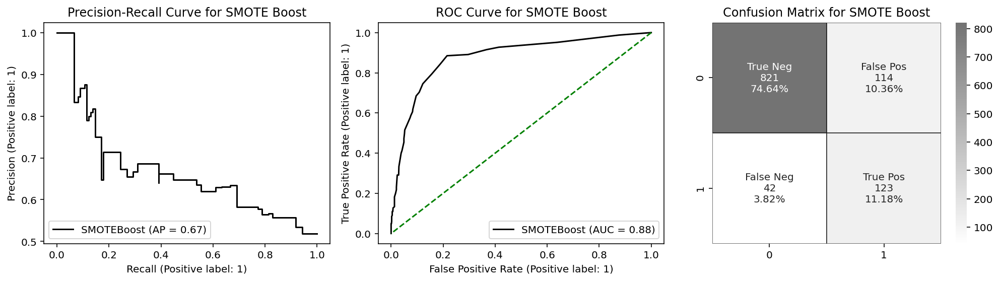

In [240]:
X_train, X_valid, y_train, y_valid = train_test_split(
    X, y, test_size=0.33, random_state=42)

stacked_metrics = {}

sb = SMOTEBoost()
cls_name = 'SMOTE Boost'

regmodel = sb.fit(X_train, y_train)
y_pred = sb.predict(X_valid)

fig, axes = plt.subplots(ncols=3, figsize=(14,4))

plot_precision_recall_curve(regmodel,X_valid,y_valid, 
            y_pred, color='black', ax=axes[0])
plot_roc_curve(regmodel,X_valid,y_valid, 
               color='black', ax=axes[1])

axes[0].set_title(f'Precision-Recall Curve for {cls_name}')
axes[1].plot([1,0],[1,0], c='green',ls='--')
axes[1].set_title(f'ROC Curve for {cls_name}')
confusion_plot(cls_name,y_valid, y_pred, axes[2])

stacked_metrics['classifier'] = cls_name
stacked_metrics['accuracy_score'] = accuracy_score(y_valid, y_pred)
stacked_metrics['ROC AUC score'] = roc_auc_score(y_valid, y_pred)
stacked_metrics['f1_score'] = f1_score(y_valid, y_pred)
stacked_metrics['recall_score'] = recall_score(y_valid, y_pred)
stacked_metrics['precision_score'] = precision_score(y_valid, y_pred)
    
plt.tight_layout()

pd.DataFrame([stacked_metrics])